# Load packages

In [1]:
# Loading the required packages to run this notebook
from src.visualisation.SummaryModels import SummaryModels
import src.utils.utils as utils
from src.visualisation.VisualiseTrajectories import VisualiseTrajectories
from src.data.Datasets import AISDiscreteRepresentation
from pathlib import Path
import pandas as pd

# Define the region to look into
region = "Bornholm"
zoom = 8
n = 6

In [2]:
# Use the SummaryModels class for everything related to the reconstructions
file_name = "RegionBornholm_01062019_30092019_Fish_14400_86400_600_Injected02"
summary_models = SummaryModels(file_name)

In [3]:
# Use the VisualiseTrajectories class for geographically visualising trajectories 
fig_size = (10, 10)
visualise_trajectories = VisualiseTrajectories(region, save_figures=True, plot_figures=True, fig_size=fig_size, zoom=zoom)
visualise_trajectories_discrete = VisualiseTrajectories(region, save_figures=True, plot_figures=True, fig_size=fig_size,
                                                        zoom=zoom, continuous_representation=False)
processed_data_dir =  visualise_trajectories.processed_data_dir

# Read the info file to know how to read the data file
data_file = processed_data_dir / ("data_" + file_name + ".pkl")
data_info_file = processed_data_dir / ("datasetInfo_" + file_name + ".pkl")
data_info = utils.read_data_info_file(data_info_file)

# Load the static Google Map image for the RIO
img = visualise_trajectories.read_static_map()

In [4]:
# Function that plots the actual and reconstructed side by side
def plot_actual_reconstructed(idx):
    # Plot a single complete vessel trajectory on the static map - Discrete representation
    visualise_trajectories_discrete.fig_size = (20,10)
    fig, ax = visualise_trajectories_discrete.visualise_static_map(img, subplots=[1, 2])
    plot_figures_tmp = visualise_trajectories_discrete.plot_figures
    visualise_trajectories_discrete.plot_figures = False
    index = df_n.iloc[idx]["Index"]
    data_set = AISDiscreteRepresentation(file_name, data_info=data_info, indicies=[index])
    df_actual = utils.get_tracks_from_dataset(data_set, continuous_representation=False)
    visualise_trajectories_discrete.plot_single_track(df_actual, ax[0], use_cmap=True)

    # Plot the corresponding model reconstruction
    index = df_n.iloc[idx]["Data set Index"]
    data_set = train_evaluate.validation_dataloader.dataset
    reconstruction = train_evaluate.track_reconstructions(data_set, index)
    df_recon = reconstruction["Reconstruction"]
    visualise_trajectories_discrete.plot_figures = plot_figures_tmp
    visualise_trajectories_discrete.plot_single_track(df_recon, ax[1], use_cmap=True)
    return {"Actual trajectory": df_actual, "Reconstructed trajectory": df_recon}

# Fishing Reconstruction Example

In [5]:
# Get some trajectories to show an example from 
data = summary_models.run_evaluation_get_n(n=100, worst=False, vessel_type="Fishing")
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

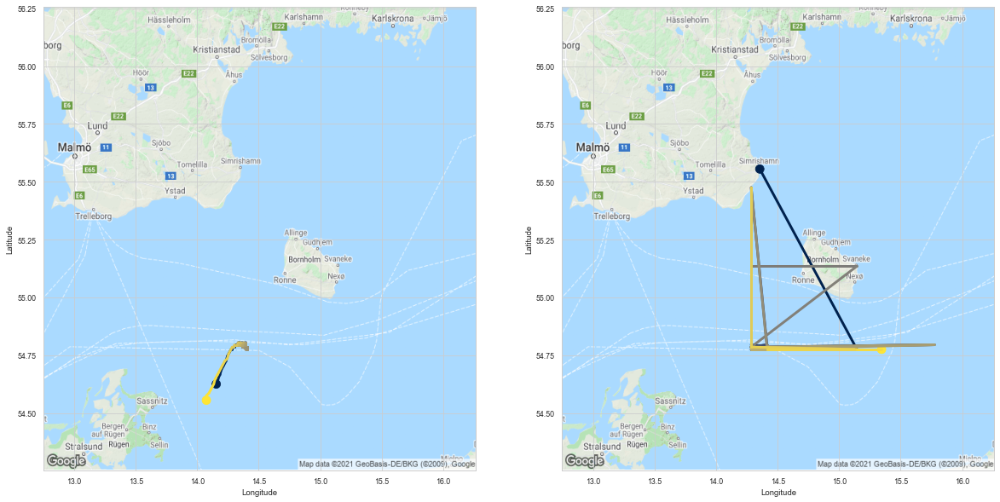

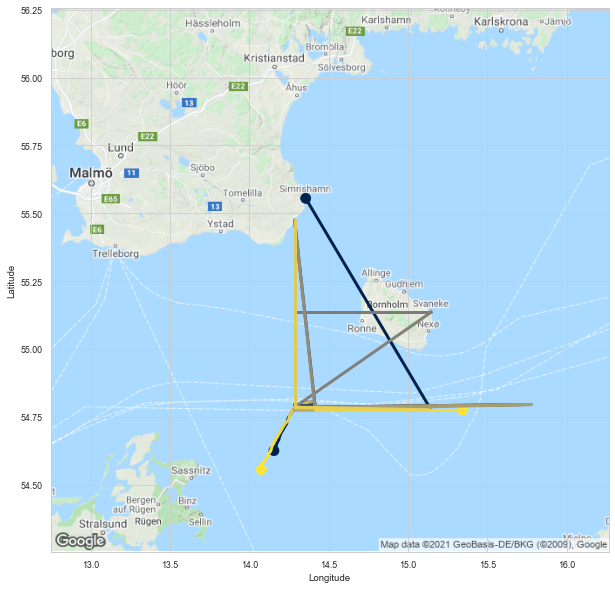

In [6]:
# Plot the actual and reconstructed trajectories side by side
tracks = plot_actual_reconstructed(97)

# Plot them on the same figure
visualise_trajectories.fig_size = fig_size
plot_figures_tmp = visualise_trajectories_discrete.plot_figures
fig, ax = visualise_trajectories.visualise_static_map(img)
visualise_trajectories_discrete.plot_figures = False
visualise_trajectories_discrete.plot_single_track(tracks["Actual trajectory"], ax, use_cmap=True)
visualise_trajectories_discrete.plot_figures = plot_figures_tmp
visualise_trajectories_discrete.plot_single_track(tracks["Reconstructed trajectory"], ax, use_cmap=True)

# Best Fishing Reconstructions

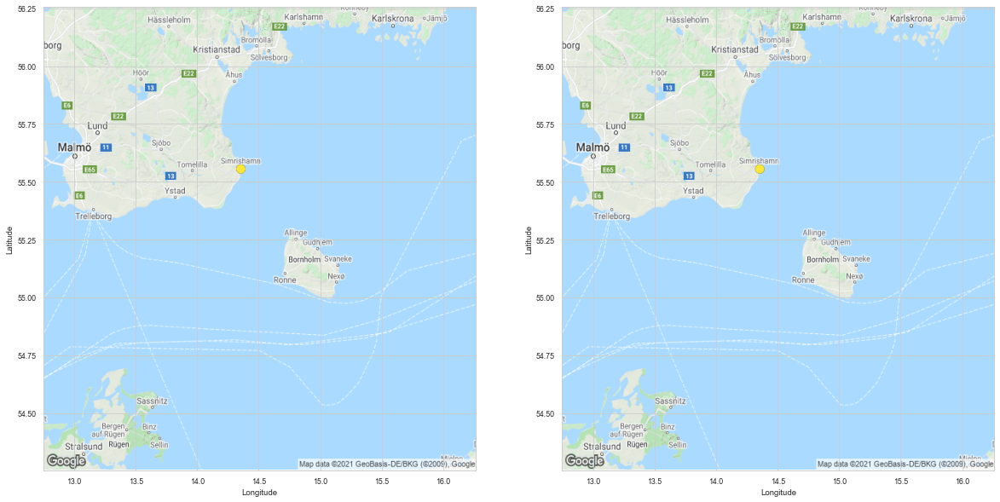

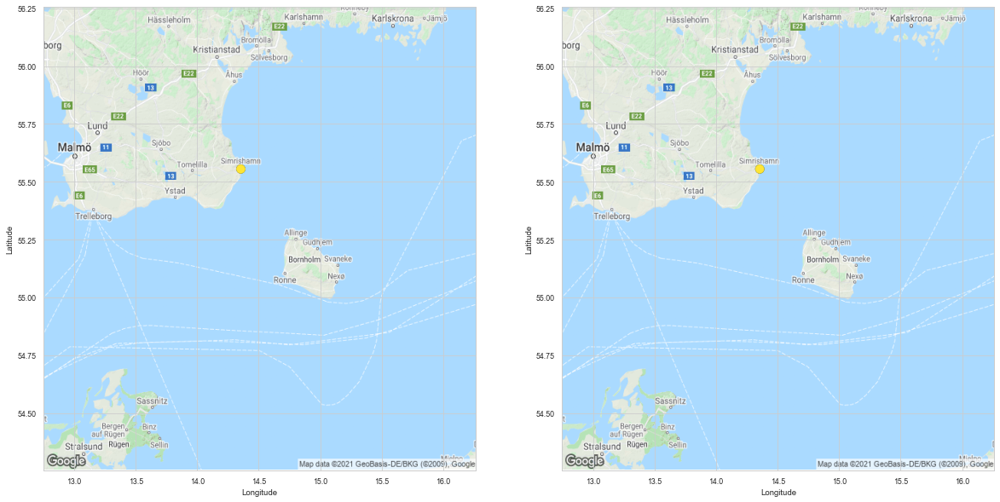

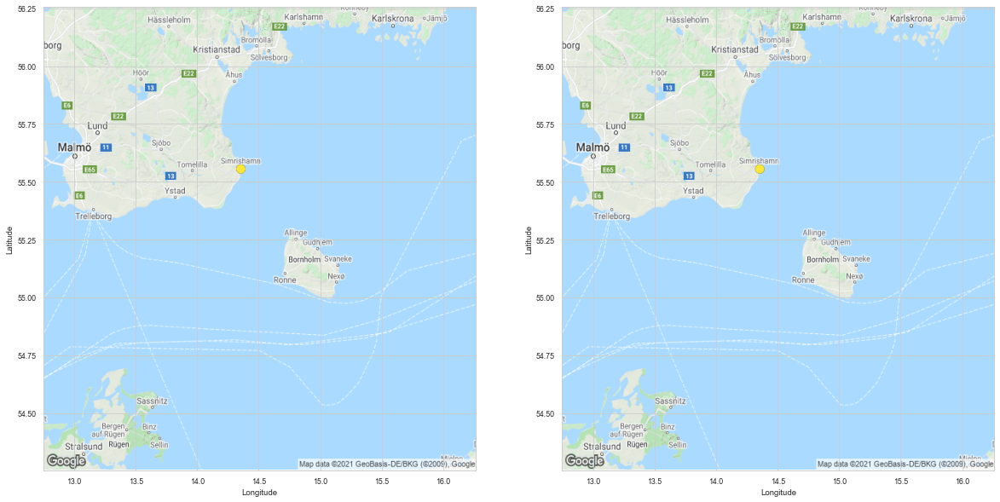

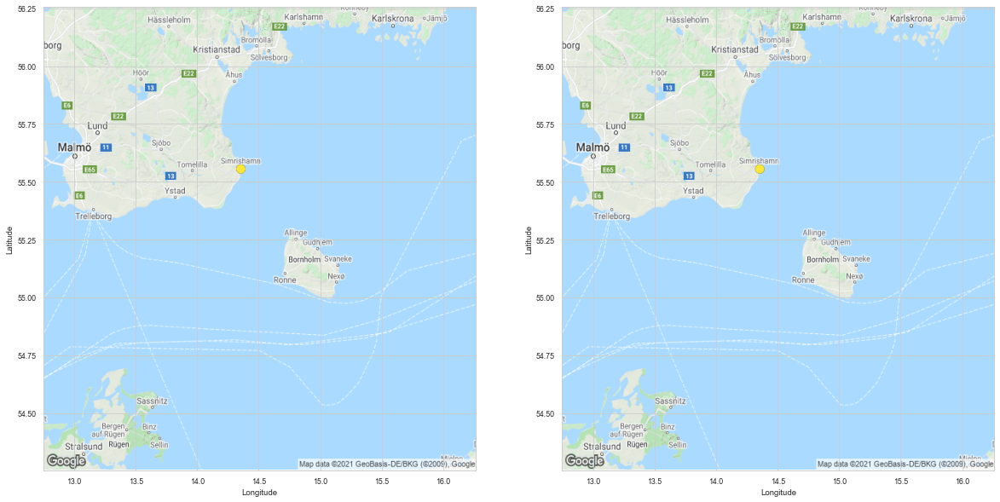

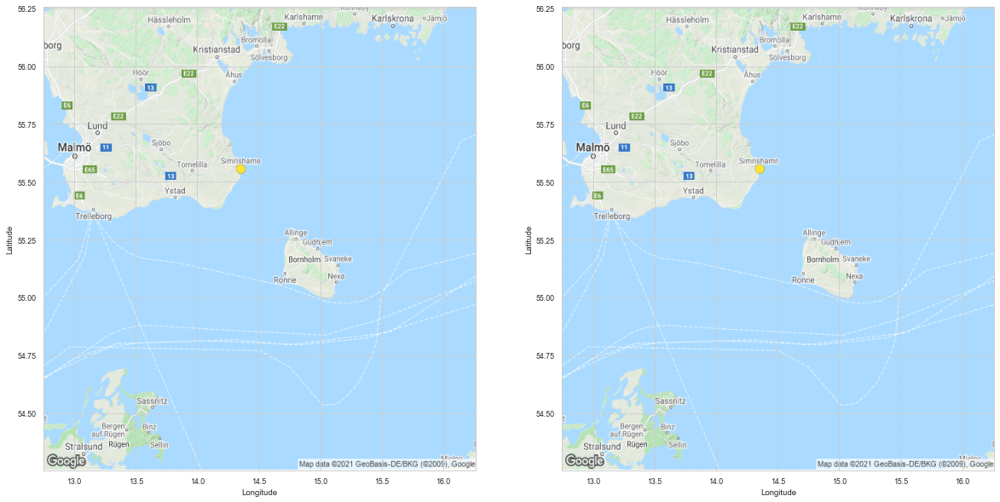

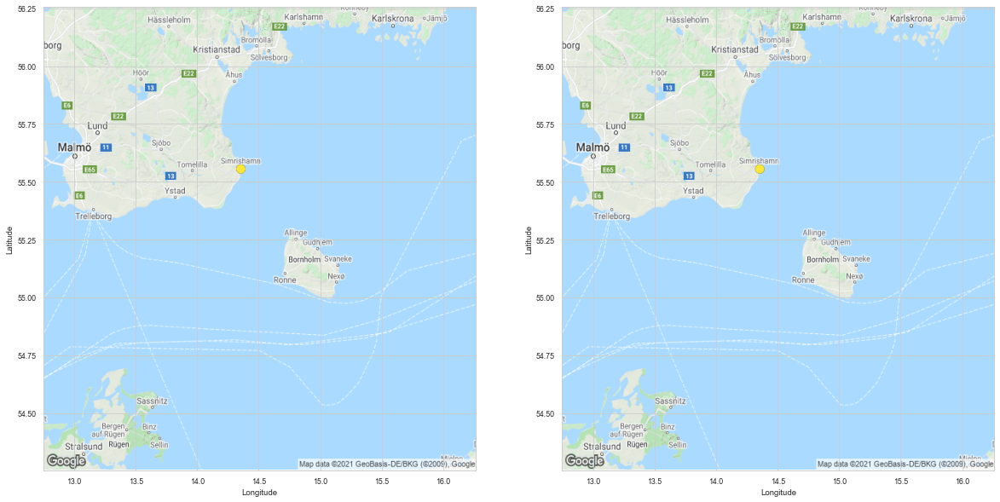

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
113,113,6371407,265755000,Fishing,141,-397.749481,-2.820918
94,94,5333916,265750000,Fishing,105,-401.326813,-3.822160
4,4,6462197,265755000,Fishing,141,-539.409241,-3.825597
91,91,6207985,265755000,Fishing,141,-540.460205,-3.833051
14,14,5349512,265750000,Fishing,58,-224.495697,-3.870615
36,36,5972813,265754000,Fishing,143,-627.433960,-4.387650


In [7]:
# Focus on the n best cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=False, vessel_type="Fishing")
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Worst Fishing Reconstructions

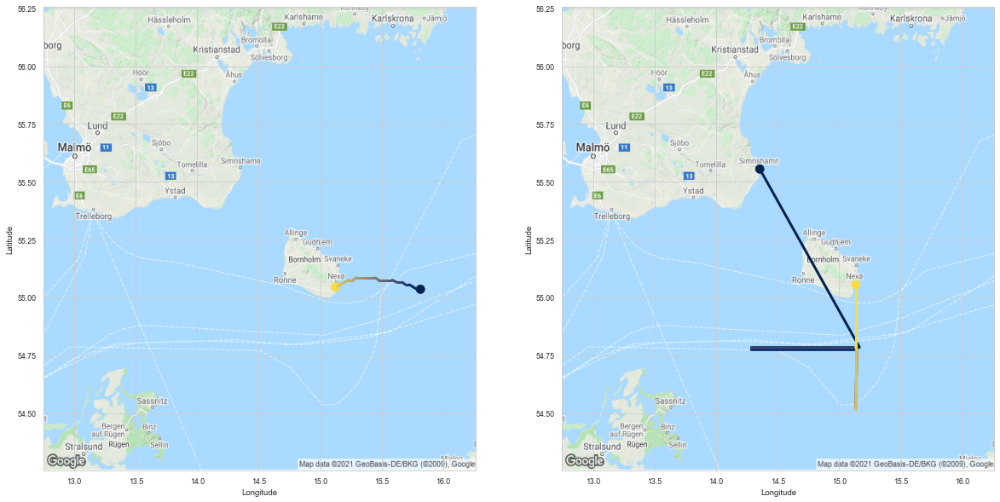

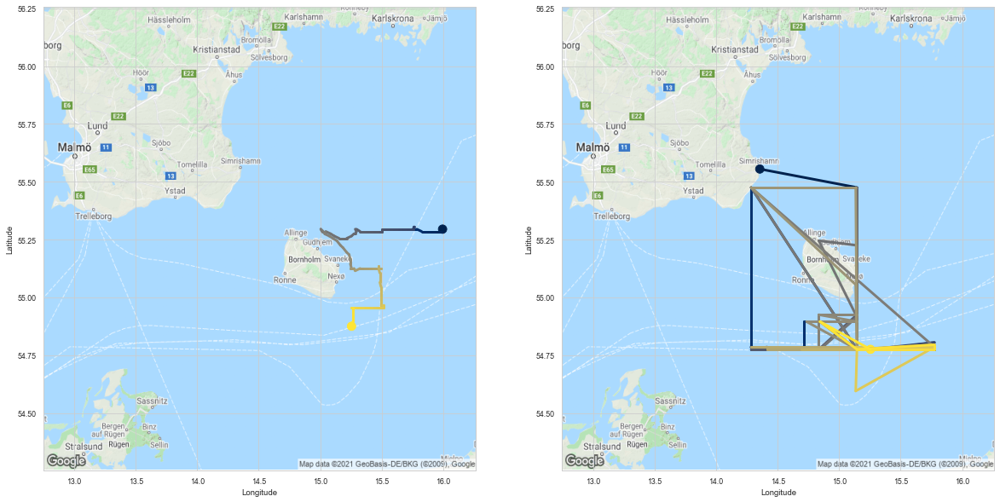

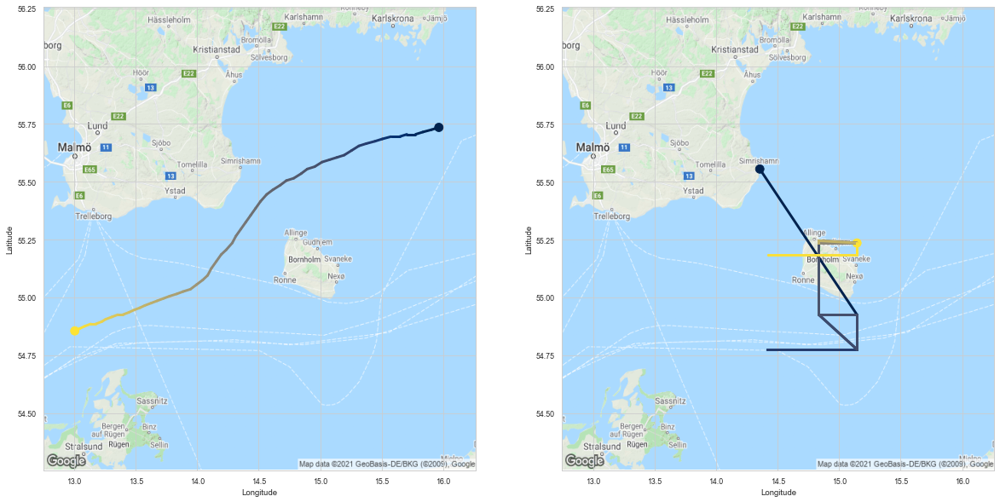

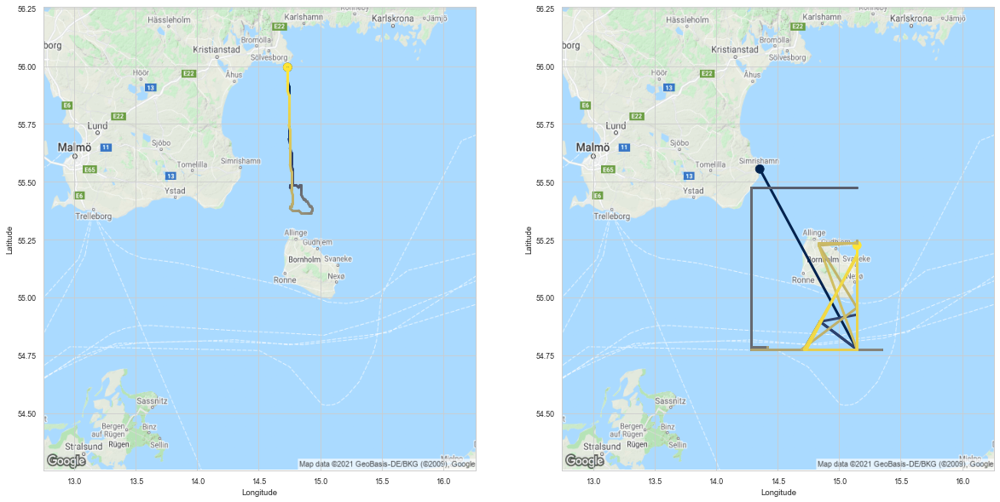

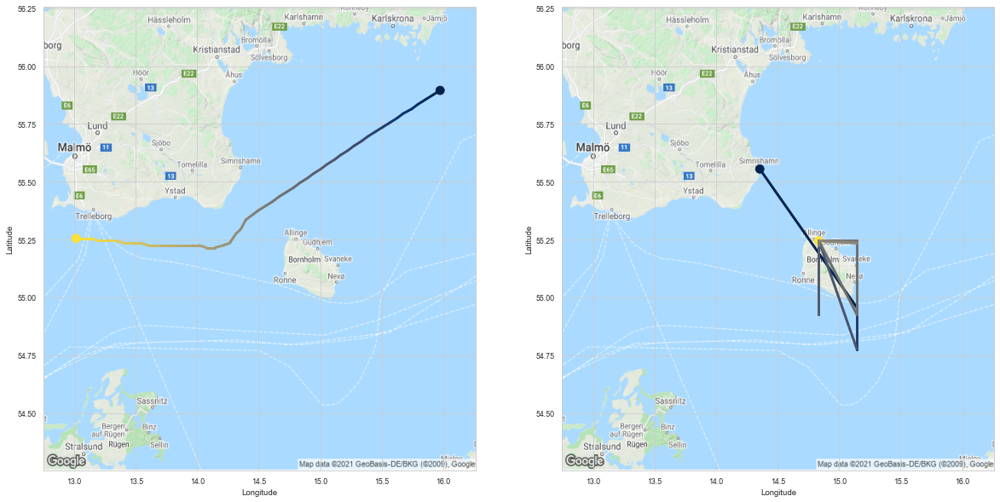

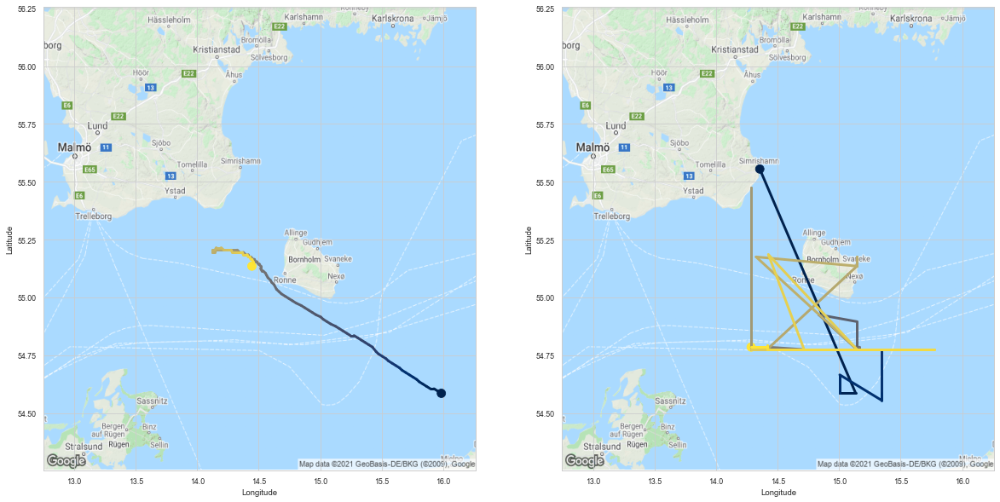

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
67,67,1072736,211474000,Fishing,27,-611.807129,-22.659523
52,52,4494420,261061000,Fishing,121,-2645.951904,-21.867371
6,6,2345350,257073000,Fishing,59,-1270.131348,-21.527650
119,119,7534870,266315000,Fishing,99,-2109.491699,-21.307997
77,77,7935865,266460000,Fishing,51,-1082.682739,-21.229073
65,65,7038024,265765000,Fishing,118,-2498.465332,-21.173435


In [8]:
# Focus on the n worst cargo reconstructions
data = summary_models.run_evaluation_get_n(n=n, worst=True, vessel_type="Fishing")
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(n): 
    tracks = plot_actual_reconstructed(idx)
df_n

# Best 100 Reconstructions

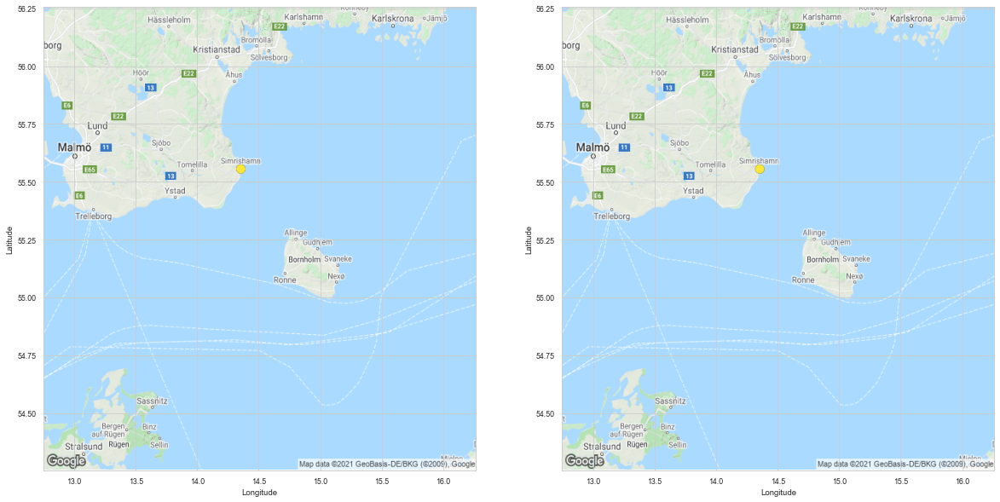

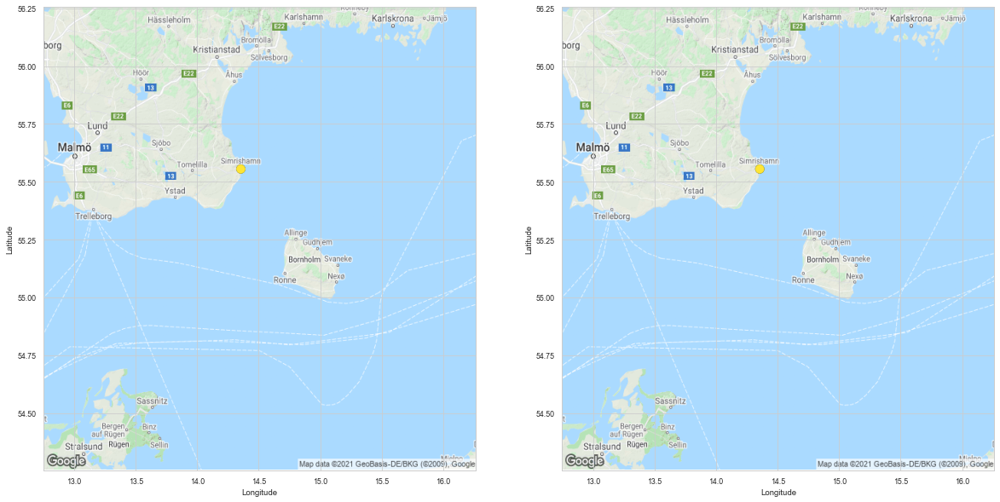

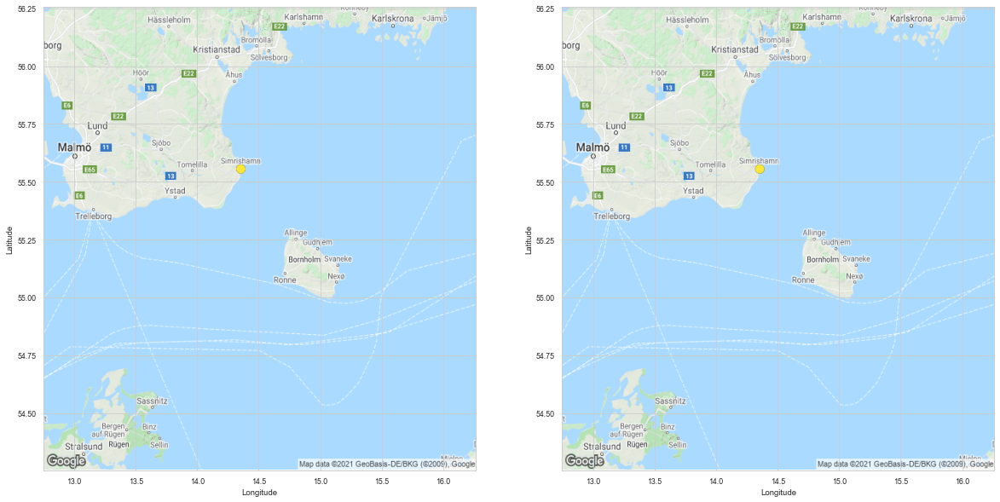

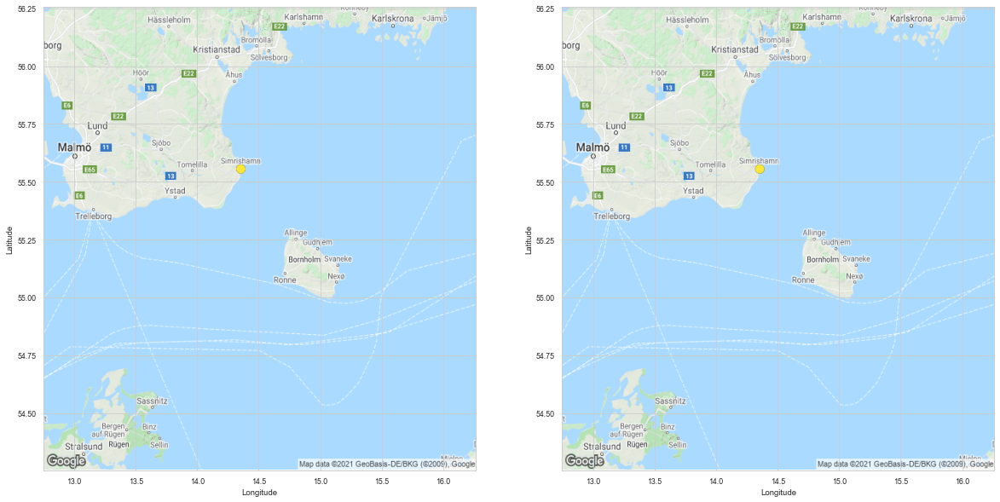

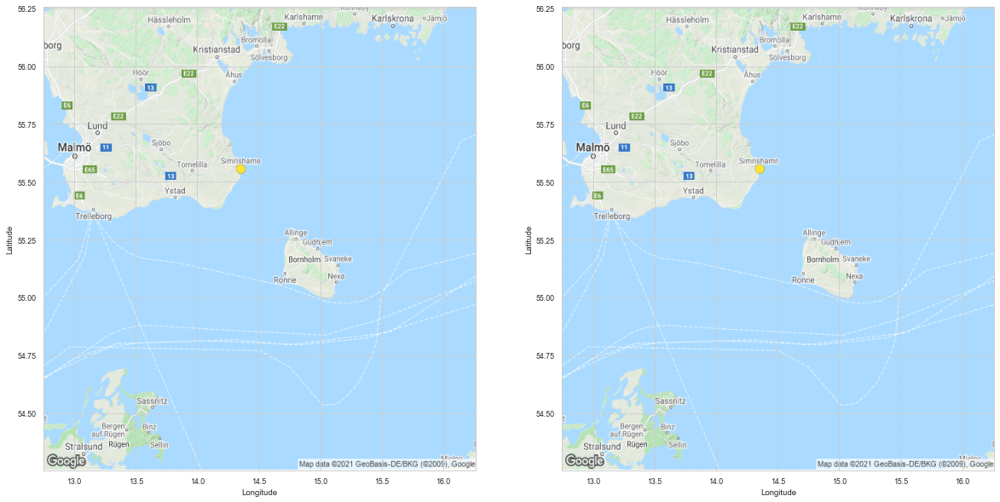

...

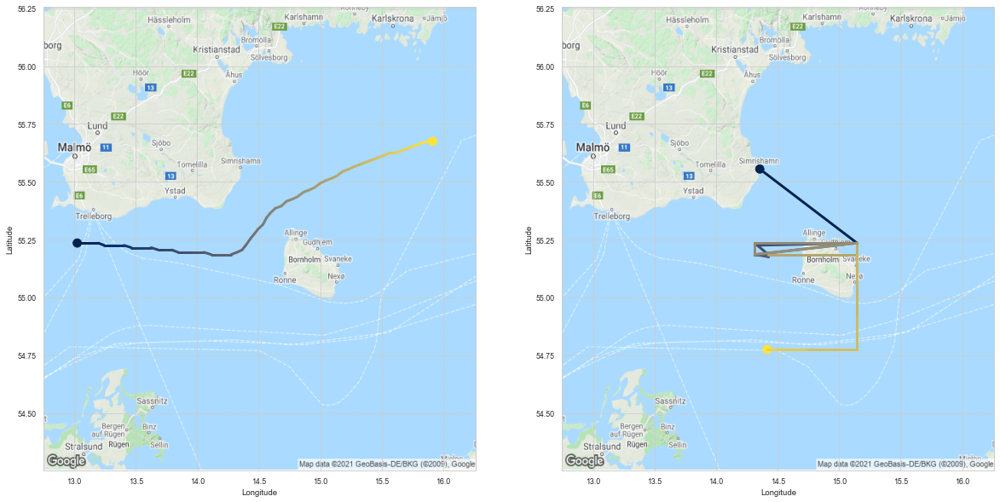

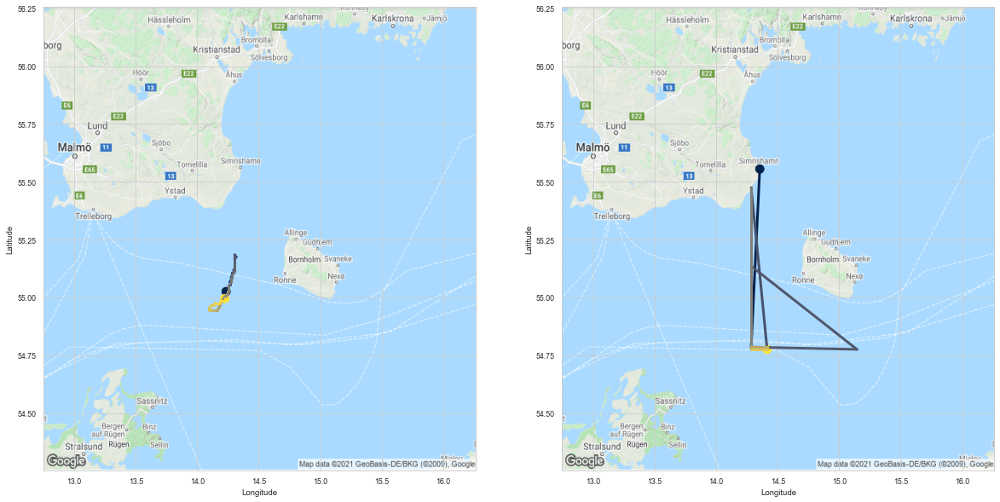

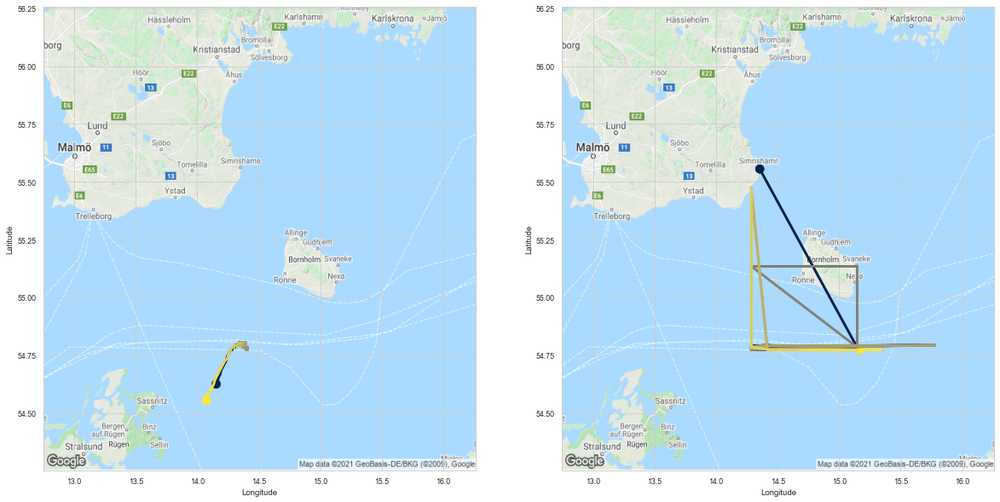

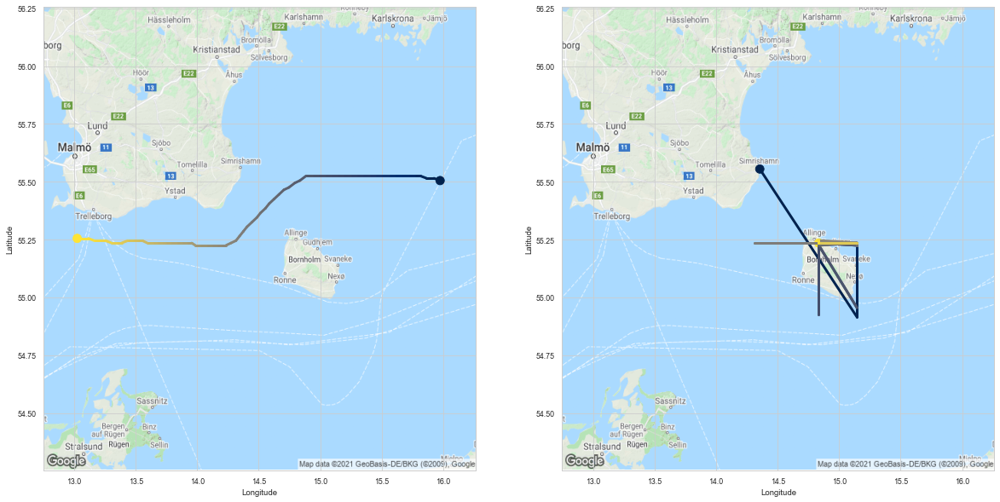

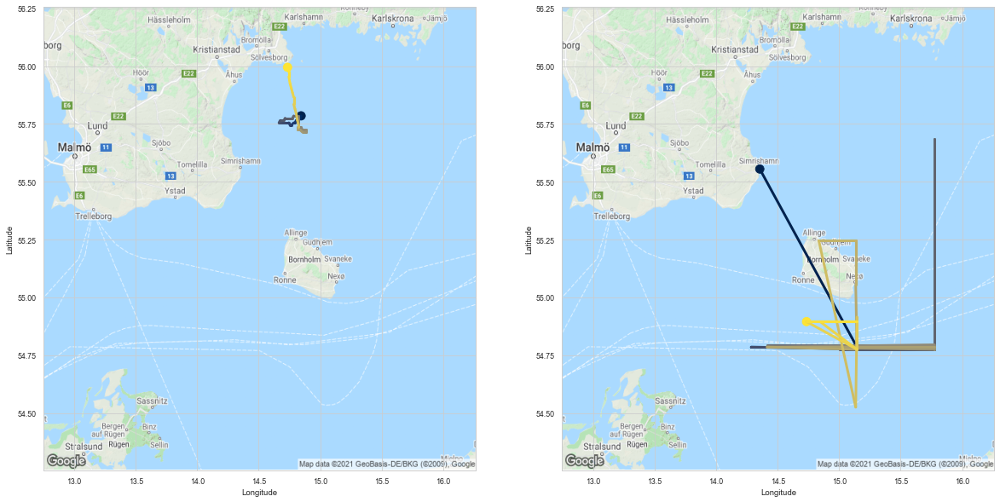

,Data set Index,Index,MMSI,Ship type,Length,Reconstruction log probability,Equally weighted reconstruction log probability
113,113,6371407,265755000,Fishing,141,-399.481781,-2.833204
94,94,5333916,265750000,Fishing,105,-399.419586,-3.803996
4,4,6462197,265755000,Fishing,141,-539.169373,-3.823896
91,91,6207985,265755000,Fishing,141,-541.001465,-3.836890
14,14,5349512,265750000,Fishing,58,-224.315033,-3.867501
...,...,...,...,...,...,...,...
58,58,7965153,273348330,Fishing,61,-1226.387939,-20.104720
15,15,3125430,261002770,Fishing,77,-1550.932129,-20.141976
59,59,1136975,211551270,Fishing,121,-2439.035645,-20.157319
90,90,7982765,273398180,Fishing,68,-1372.362305,-20.181799


In [9]:
# Focus on the overall n=100 best reconstructions
data = summary_models.run_evaluation_get_n(n=100, worst=False, vessel_type="Fishing")
df_n = data["TrajectoryLevelData"]
train_evaluate = data["TrainEvaluateObject"]

# Plot the actual and reconstructed trajectories side by side
for idx in range(100): 
    tracks = plot_actual_reconstructed(idx)
df_n